# Cell Bin

In [15]:
import stereo as st
from matplotlib import pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [3]:
import os

os.chdir('/home/mowp/data/stereo-seq/Demo_MouseBrain')

In [25]:
data_path = 'SS200000135TL_D1.cellbin.gef'
st.io.read_gef_info(data_path)

[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1116][INFO]: This is GEF file which contains cell bin infomation.
[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1117][INFO]: bin_type: cell_bins
[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1123][INFO]: Number of cells: 57133
[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1126][INFO]: Number of gene: 24670
[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1129][INFO]: Resolution: 500
[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1132][INFO]: offsetX: 0
[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1135][INFO]: offsetY: 0
[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1138][INFO]: Average number of genes: 223.460693359375
[2023-10-13 12:13:52][Stereo][2082839][MainThread][140212501497664][reader][1141][INFO]: M

version is 0.7.14 

{'cell_num': 57133,
 'gene_num': 24670,
 'resolution': 500,
 'offsetX': 0,
 'offsetY': 0,
 'averageGeneCount': 223.4607,
 'maxGeneCount': 1046,
 'averageExpCount': 399.17035,
 'maxExpCount': 2337}

In [26]:
data = st.io.read_gef(file_path=data_path, bin_type='cell_bins')

# simply type the varibale to get related information
data

[2023-10-13 12:13:53][Stereo][2082839][MainThread][140212501497664][reader][956][INFO]: read_gef begin ...


version is 0.7.14 

[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][993][INFO]: the matrix has 57133 cells, and 24670 genes.
[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][1116][INFO]: This is GEF file which contains cell bin infomation.
[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][1117][INFO]: bin_type: cell_bins
[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][1123][INFO]: Number of cells: 57133
[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][1126][INFO]: Number of gene: 24670
[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][1129][INFO]: Resolution: 500
[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][1132][INFO]: offsetX: 0
[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][1135][INFO]: offsetY: 0
[2023-10-13 12:13:55][Stereo][2082839][MainThread][140212501497664][reader][1138][INFO]:

version is 0.7.14 

StereoExpData object with n_cells X n_genes = 57133 X 24670
bin_type: cell_bins
offset_x = None
offset_y = None
cells: ['cell_name']
genes: ['gene_name']

# Preprocessing

## Quality control

In [27]:
data.tl.cal_qc()

[2023-10-13 12:13:57][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run cal_qc...
[2023-10-13 12:13:57][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: cal_qc end, consume time 0.2146s.


In [28]:
data

StereoExpData object with n_cells X n_genes = 57133 X 24670
bin_type: cell_bins
offset_x = None
offset_y = None
cells: ['cell_name', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt']
genes: ['gene_name', 'n_cells', 'n_counts', 'mean_umi']

Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

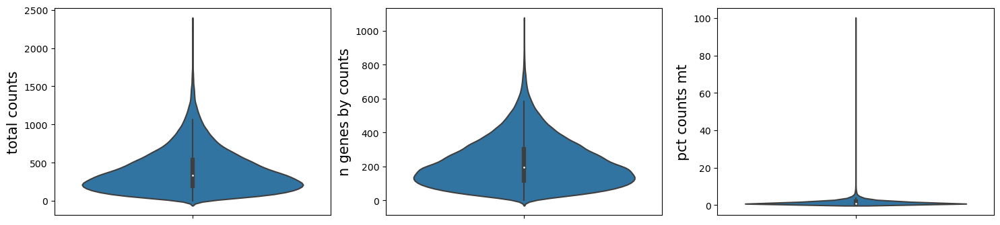

In [29]:
data.plt.violin()

Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

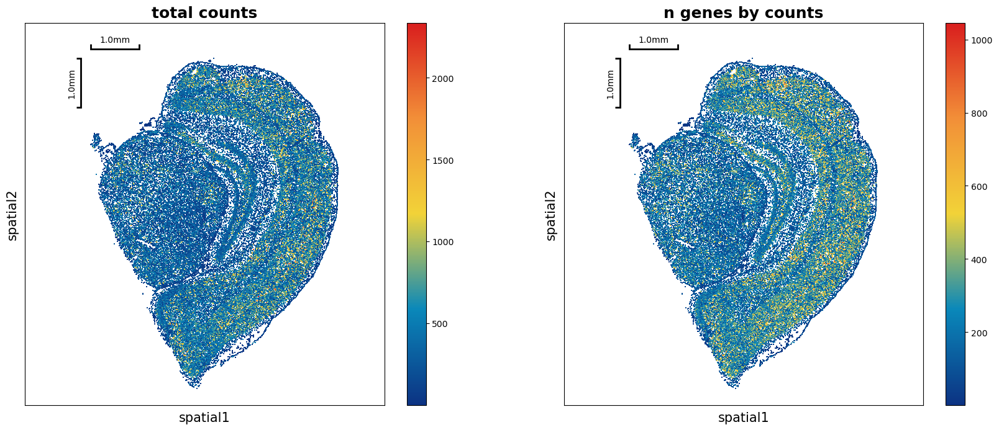

In [30]:
data.plt.spatial_scatter()

## Filtering

Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

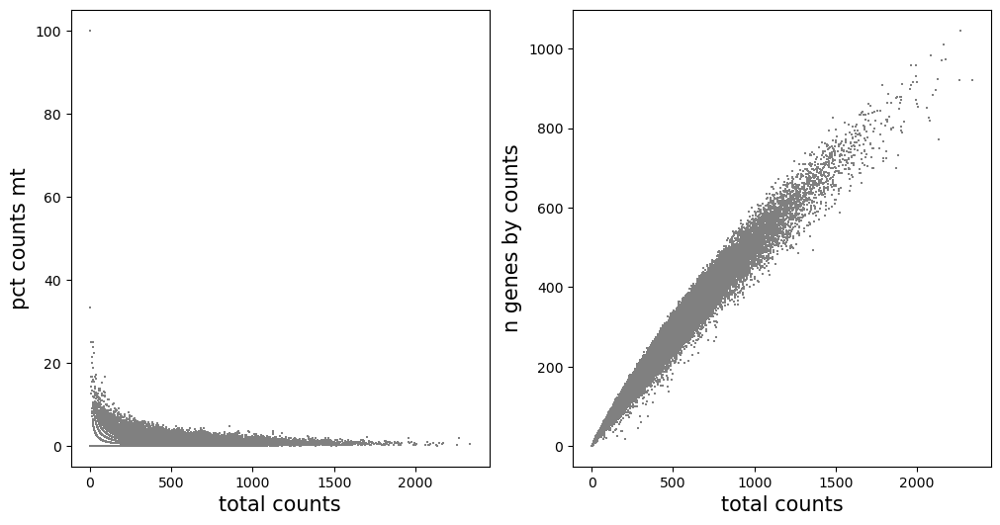

In [31]:
data.plt.genes_count()

In [32]:
data.tl.filter_cells(
        min_gene=200,
        min_n_genes_by_counts=3,
        max_n_genes_by_counts=2500,
        pct_counts_mt=5,
        inplace=True
        )
data

[2023-10-13 12:14:23][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run filter_cells...
[2023-10-13 12:14:23][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: filter_cells end, consume time 0.2893s.


StereoExpData object with n_cells X n_genes = 41948 X 24670
bin_type: cell_bins
offset_x = None
offset_y = None
cells: ['cell_name', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt']
genes: ['gene_name', 'n_cells', 'n_counts', 'mean_umi']

In [33]:
data.tl.raw_checkpoint()

In [34]:
data.tl.raw

StereoExpData object with n_cells X n_genes = 41948 X 24670
bin_type: cell_bins
offset_x = None
offset_y = None
cells: ['cell_name', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt']
genes: ['gene_name', 'n_cells', 'n_counts', 'mean_umi']

## Normalization

In [35]:
data.tl.normalize_total()
data.tl.log1p()

[2023-10-13 12:15:29][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run normalize_total...
[2023-10-13 12:15:29][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: normalize_total end, consume time 0.1130s.
[2023-10-13 12:15:29][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run log1p...
[2023-10-13 12:15:29][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: log1p end, consume time 0.1666s.


In [36]:
data.tl.highly_variable_genes(
            min_mean=0.0125,
            max_mean=3,
            min_disp=0.5,
            n_top_genes=2000,
            res_key='highly_variable_genes'
            )

[2023-10-13 12:15:38][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run highly_variable_genes...
[2023-10-13 12:15:40][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: highly_variable_genes end, consume time 1.2478s.


Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

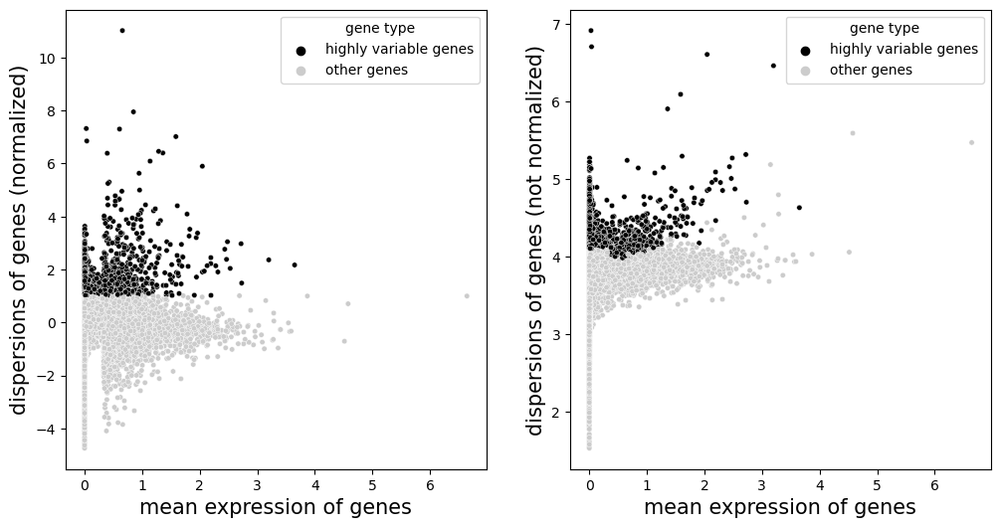

In [37]:
# remember to choose a res_key when plot

data.plt.highly_variable_genes(res_key='highly_variable_genes')

In [38]:
data.tl.scale()

[2023-10-13 12:16:07][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run scale...
[2023-10-13 12:16:15][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: scale end, consume time 8.0925s.


# Embedding

## PCA

In [39]:
data.tl.pca(
        use_highly_genes=True,
        n_pcs=30,
        res_key='pca'
        n_jobs=30
        )

[2023-10-13 12:16:22][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run pca...
[2023-10-13 12:16:25][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: pca end, consume time 3.4741s.


## Neighborhood graph

In [40]:
data.tl.neighbors(pca_res_key='pca', res_key='neighbors')

[2023-10-13 12:17:04][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run neighbors...
[2023-10-13 12:17:22][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: neighbors end, consume time 17.5399s.


In [41]:
data

StereoExpData object with n_cells X n_genes = 41948 X 24670
bin_type: cell_bins
offset_x = None
offset_y = None
cells: ['cell_name', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt']
genes: ['gene_name', 'n_cells', 'n_counts', 'mean_umi', 'hvgs']
cells_matrix = ['pca']
cells_pairwise = ['neighbors']
key_record: {'hvg': ['highly_variable_genes'], 'pca': ['pca'], 'neighbors': ['neighbors']}

## UMAP

In [42]:
data.tl.umap(
        pca_res_key='pca',
        neighbors_res_key='neighbors',
        res_key='umap'
        )

[2023-10-13 12:17:49][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run umap...


	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs


[2023-10-13 12:18:04][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: umap end, consume time 14.9389s.


Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

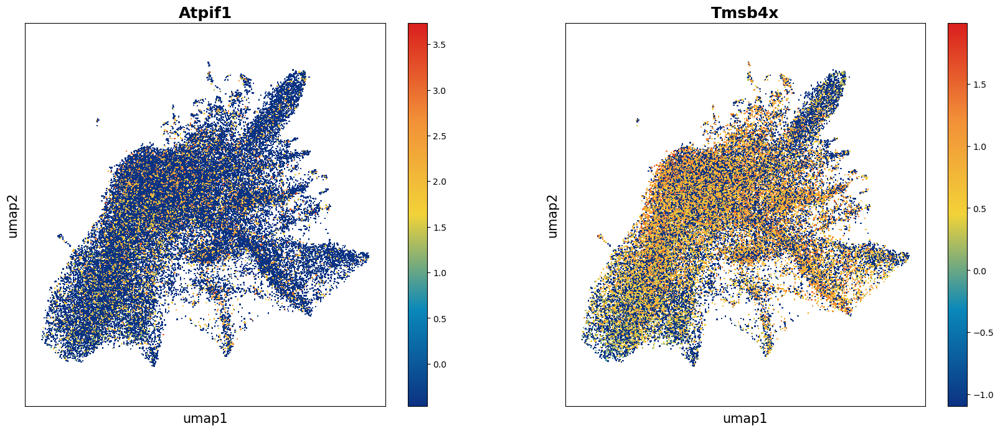

In [43]:
data.plt.umap(gene_names=['Atpif1', 'Tmsb4x'], res_key='umap')

## Clustering

In [44]:
data.tl.leiden(neighbors_res_key='neighbors',res_key='leiden')

[2023-10-13 12:18:39][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run leiden...
[2023-10-13 12:18:47][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: leiden end, consume time 8.2969s.


Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

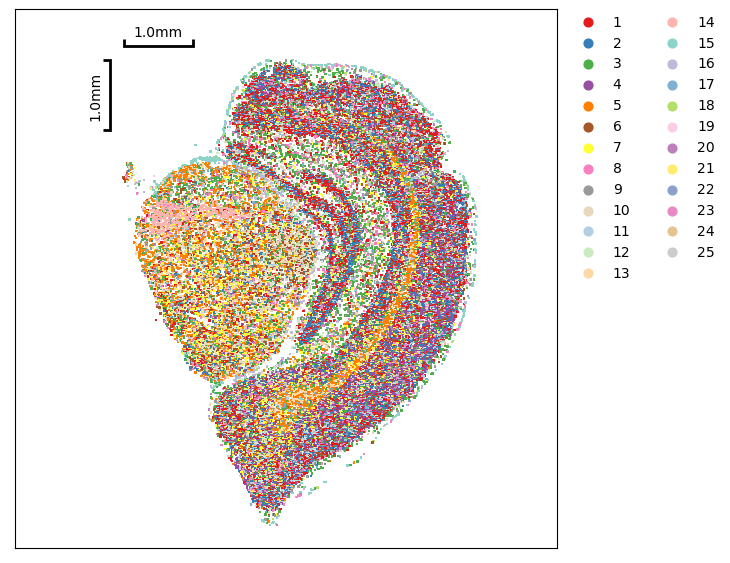

In [45]:
data.plt.cluster_scatter(res_key='leiden')

Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

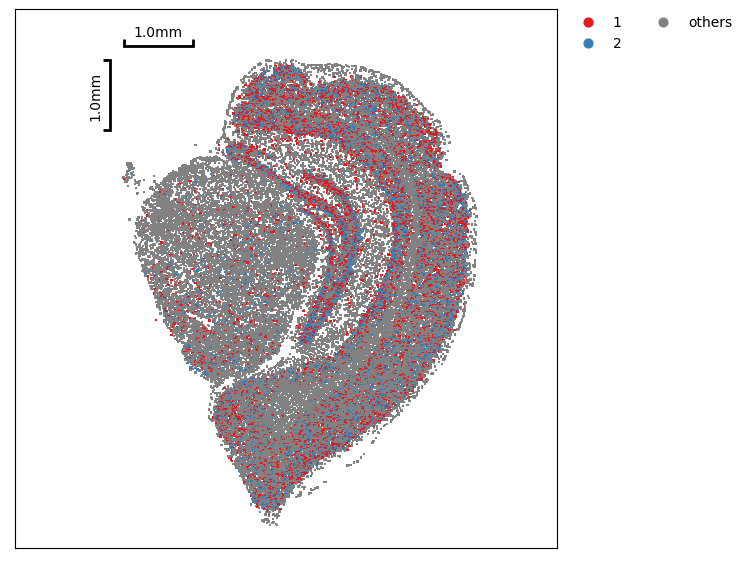

In [46]:
data.plt.cluster_scatter(res_key='leiden', groups=['1', '2'])

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
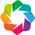

Row
    [0] Column
        [0] ParamFunction(function)
    [1] Column
        [0] Select(name='color theme', options=['rainbow', 'fire', ...], value='stereo', visible=False, width=200)
        [1] Select(name='color theme', options=['glasbey', 'glasbey_bw', ...], value='stereo_30', width=200)
        [2] Select(name='color by', options=['cluster', 'total_count',...], value='cluster', width=200)
        [3] Checkbox(disabled=True, name='reverse colormap')
        [4] Row
            [0] Select(name='cluster', options=['1', '2', '3', ...], value='1', width=100)
            [1] ColorPicker(name='cluster color', value='#E41A1C', width=70)

In [48]:
data.plt.cells_plotting(cluster_res_key='leiden')

Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

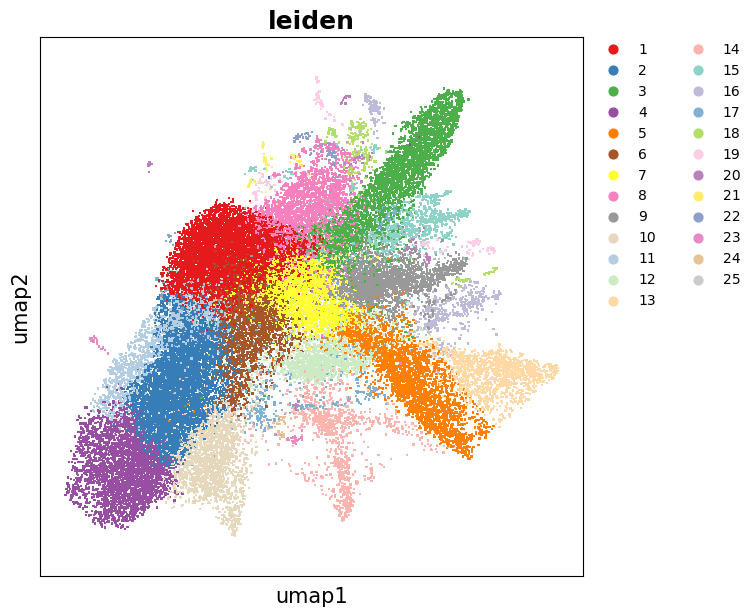

In [49]:
data.plt.umap(res_key='umap', cluster_key='leiden')

# Find Marker Genes

In [51]:
data.tl.find_marker_genes(
        cluster_res_key='leiden',
        method='t_test',
        use_highly_genes=False,
        use_raw=True
        )

[2023-10-13 12:22:57][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run find_marker_genes...
[2023-10-13 12:22:57][Stereo][2082839][MainThread][140212501497664][tool_base][119][INFO]: read group information, grouping by group column.
[2023-10-13 12:22:57][Stereo][2082839][MainThread][140212501497664][tool_base][157][INFO]: start to run...
[2023-10-13 12:22:57][Stereo][2082839][MainThread][140212501497664][time_consume][55][INFO]: start to run calc_pct_and_pct_rest...
[2023-10-13 12:22:59][Stereo][2082839][MainThread][140212501497664][time_consume][58][INFO]: calc_pct_and_pct_rest end, consume time 1.5139s.
Find marker gene: 100%|██████████| 25/25 [00:05<00:00,  4.25it/s]
[2023-10-13 12:23:05][Stereo][2082839][MainThread][140212501497664][tool_base][159][INFO]: end to run.
[2023-10-13 12:23:05][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: find_marker_genes end, consume time 7.4810s.


Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

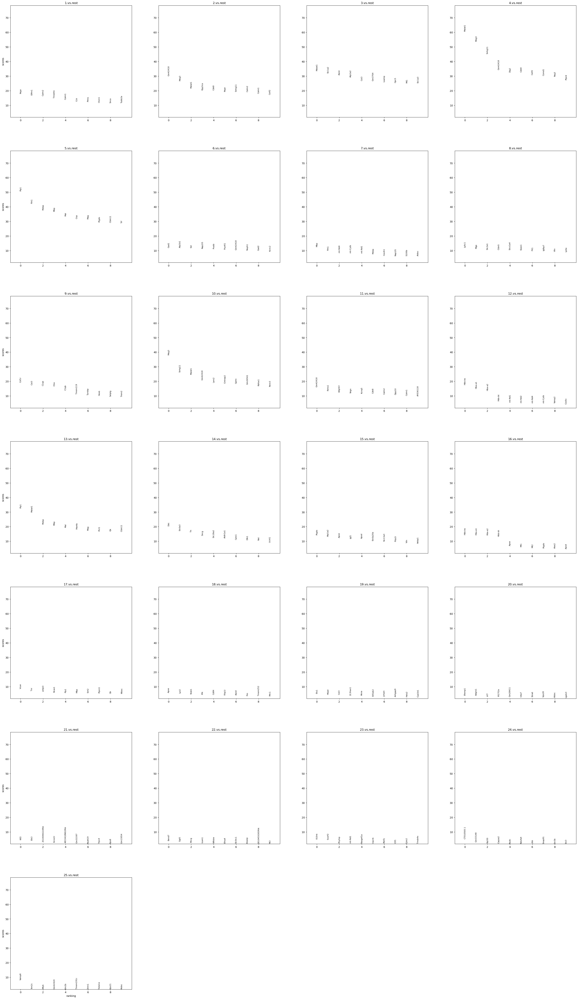

In [52]:
data.plt.marker_genes_text(
        res_key='marker_genes',
        markers_num=10,
        sort_key='scores'
        )

Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

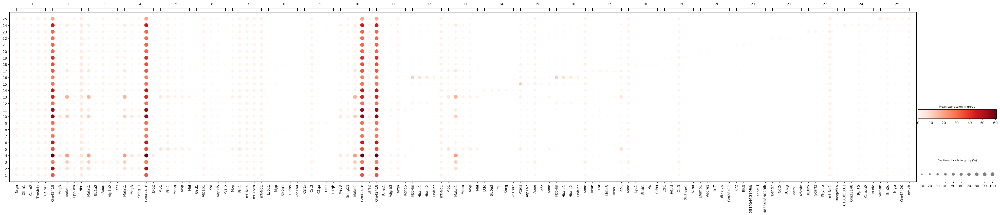

In [53]:
data.plt.marker_genes_scatter(res_key='marker_genes', markers_num=5)

Column
    [0] Markdown(str)
    [1] Row
        [0] TextInput(name='file name', placeholder='Enter a file name...', width=200)
        [1] IntInput(name='dpi', placeholder='Enter the dip...', start=0, value=100, width=200)
    [2] Row
        [0] Button(button_type='primary', name='export', width=100)
        [1] StaticText(width=800)

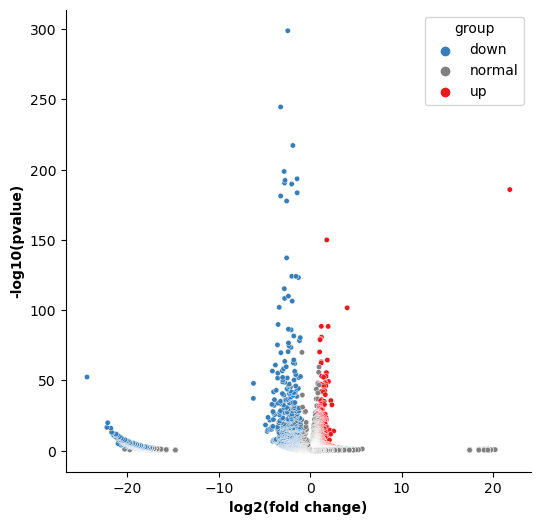

In [54]:
data.plt.marker_gene_volcano(group_name='2.vs.rest', vlines=False)

You can also filter out genes based on log fold change and fraction of genes expressing the gene within and outside each group.

In [55]:
data.tl.filter_marker_genes(
    marker_genes_res_key='marker_genes',
    min_fold_change=1,
    min_in_group_fraction=0.25,
    max_out_group_fraction=0.5,
    res_key='marker_genes_filtered'
)

[2023-10-13 12:23:41][Stereo][2082839][MainThread][140212501497664][st_pipeline][37][INFO]: start to run filter_marker_genes...
[2023-10-13 12:23:42][Stereo][2082839][MainThread][140212501497664][st_pipeline][40][INFO]: filter_marker_genes end, consume time 1.2047s.


In [56]:
data

StereoExpData object with n_cells X n_genes = 41948 X 24670
bin_type: cell_bins
offset_x = None
offset_y = None
cells: ['cell_name', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'leiden']
genes: ['gene_name', 'n_cells', 'n_counts', 'mean_umi', 'hvgs']
cells_matrix = ['pca', 'umap']
cells_pairwise = ['neighbors']
key_record: {'hvg': ['highly_variable_genes'], 'pca': ['pca'], 'neighbors': ['neighbors'], 'umap': ['umap'], 'cluster': ['leiden'], 'marker_genes': ['marker_genes', 'marker_genes_filtered'], 'gene_exp_cluster': ['gene_exp_leiden']}

In [57]:
adata = st.io.stereo_to_anndata(data, flavor='scanpy')

[2023-10-13 12:24:18][Stereo][2082839][MainThread][140212501497664][reader][711][INFO]: Adding sample in adata.obs['orig.ident'].
[2023-10-13 12:24:18][Stereo][2082839][MainThread][140212501497664][reader][714][INFO]: Adding data.position as adata.obsm['spatial'] .
[2023-10-13 12:24:18][Stereo][2082839][MainThread][140212501497664][reader][719][INFO]: Adding data.position as adata.obs['x'] and adata.obs['y'] .
[2023-10-13 12:24:18][Stereo][2082839][MainThread][140212501497664][reader][745][INFO]: Adding data.tl.result['highly_variable_genes'] into adata.var .
[2023-10-13 12:24:18][Stereo][2082839][MainThread][140212501497664][reader][766][INFO]: Adding data.tl.result['pca'] into adata.obsm['X_pca'] .
[2023-10-13 12:24:18][Stereo][2082839][MainThread][140212501497664][reader][774][INFO]: Adding data.tl.result['neighbors']['connectivities'] into adata.obsp['connectivities'] .
[2023-10-13 12:24:18][Stereo][2082839][MainThread][140212501497664][reader][775][INFO]: Adding data.tl.result['ne

In [58]:
adata

AnnData object with n_obs × n_vars = 41948 × 24670
    obs: 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'leiden', 'orig.ident', 'x', 'y'
    var: 'n_cells', 'n_counts', 'mean_umi', 'hvgs', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'gene type'
    uns: 'bin_type', 'bin_size', 'resolution', 'sn', 'hvg', 'neighbors', 'gene_exp_cluster@gene_exp_leiden'
    obsm: 'spatial', 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [59]:
adata.obs

,total_counts,n_genes_by_counts,pct_counts_mt,leiden,orig.ident,x,y
31546534795506,209,127,1.435407,15,sample,7345.0,6386.0
31903017081074,221,143,1.357466,15,sample,7428.0,6386.0
34029025892591,236,156,3.813559,9,sample,7923.0,6383.0
34913789155561,297,175,3.367003,15,sample,8129.0,6377.0
34754875365614,446,215,3.811659,15,sample,8092.0,6382.0
...,...,...,...,...,...,...,...
32809255193826,227,110,2.202643,15,sample,7639.0,19682.0
32392643366082,468,213,1.282051,15,sample,7542.0,19650.0
32066225851642,230,130,2.173913,15,sample,7466.0,19706.0
32933809245432,259,129,2.702703,20,sample,7668.0,19704.0
